# Problem 8.3: σ factor activity, 30 pts extra credit
In this problem, we will fully work up the data we studied in Tutorial 9b. You downloaded the data via Dropbox. We will consider all images starting with snaps001, snaps002, and snaps003. Be sure to read the README.pdf file from Jin Park describing the data set.

a) Segment all images using the RFP channel, and then compute the mean intensity of each bacterium in the CFP and YFP channels. Show a representative segmentation (one each for the 001, 002, and 003 sets) by overlaying your binary segmented image on a phase image.

In [1]:
import warnings

# Workhorse
import numpy as np
import pandas as pd

# Find files
import glob
import os

# A whole bunch of skimage stuff
import skimage.feature
import skimage.filter
import skimage.filter.rank
import skimage.io
import skimage.morphology
import skimage.restoration
import skimage.segmentation
import skimage.transform

# Regionprops_to_df
import sys
sys.path.insert(0, '/Users/chigozie/git/regionprops_to_df/')
import regionprops_to_df

# And some useful scipy.ndimage stuff
import scipy.ndimage

# Import plotting tools
import matplotlib.pyplot as plt
import seaborn as sns

# Interaction
import ipywidgets

# Magic function to make matplotlib inline; other style specs must come AFTER
%matplotlib inline

# This enables high res graphics inline (only use with static plots (non-Bokeh))
# SVG is preferred, but there is a bug in Jupyter with vertical lines
%config InlineBackend.figure_formats = {'png', 'retina'}

# JB's favorite Seaborn settings for notebooks
rc = {'lines.linewidth': 2, 
      'axes.labelsize': 18, 
      'axes.titlesize': 18, 
      'axes.facecolor': 'DFDFE5'}
sns.set_context('notebook', rc=rc)
sns.set_style('darkgrid', rc=rc)

# Suppress future warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

//anaconda/lib/python3.4/site-packages/skimage/filter/__init__.py:6: skimage_deprecation: The `skimage.filter` module has been renamed to `skimage.filters`.  This placeholder module will be removed in v0.13.
  warn(skimage_deprecation('The `skimage.filter` module has been renamed '
//anaconda/lib/python3.4/site-packages/matplotlib/__init__.py:872: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


In [2]:
# The directory containing daytime data
data_dir = '../../bebi103/data/park_et_al/'

# Glob string for images
im_list = []
for i in range(1,4):
    im_glob = os.path.join(data_dir, 'snaps00%s*.tif' % i)
    im_list += glob.glob(im_glob)

# Let's look at the first 10 entries
im_list[:10]

['../../bebi103/data/park_et_al/snaps001-001-c.tif',
 '../../bebi103/data/park_et_al/snaps001-001-p.tif',
 '../../bebi103/data/park_et_al/snaps001-001-r.tif',
 '../../bebi103/data/park_et_al/snaps001-001-y.tif',
 '../../bebi103/data/park_et_al/snaps001-002-c.tif',
 '../../bebi103/data/park_et_al/snaps001-002-p.tif',
 '../../bebi103/data/park_et_al/snaps001-002-r.tif',
 '../../bebi103/data/park_et_al/snaps001-002-y.tif',
 '../../bebi103/data/park_et_al/snaps001-003-c.tif',
 '../../bebi103/data/park_et_al/snaps001-003-p.tif']

In [3]:
# Make data frame containing images
df = pd.DataFrame(columns=['strain', 'field_of_view', 'channel', 'filepath', 'image', 'histogram'])
df.filepath = im_list
df.strain = [i[-13:-10] for i in df.filepath]
df.field_of_view = [i[-9:-6] for i in df.filepath]
df.channel = [i[-5] for i in df.filepath]
df.image = [skimage.io.imread(i) for i in df.filepath]
df.histogram = [skimage.exposure.histogram(im) for im in df.image]
# Take a look
df.head()

,strain,field_of_view,channel,filepath,image,histogram
0,001,001,c,../../bebi103/data/park_et_al/snaps001-001-c.tif,"[[441, 421, 443, 458, 422, 424, 399, 427, 423,...","([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 4, 3,..."
1,001,001,p,../../bebi103/data/park_et_al/snaps001-001-p.tif,"[[1321, 1364, 1293, 1313, 1297, 1338, 1347, 13...","([1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 2, 0, 1, 0, 0,..."
2,001,001,r,../../bebi103/data/park_et_al/snaps001-001-r.tif,"[[243, 261, 250, 243, 250, 273, 247, 262, 256,...","([1, 0, 0, 1, 0, 4, 2, 3, 10, 7, 16, 10, 36, 5..."
3,001,001,y,../../bebi103/data/park_et_al/snaps001-001-y.tif,"[[385, 338, 369, 392, 366, 377, 353, 371, 374,...","([1, 1, 1, 1, 3, 5, 6, 5, 8, 20, 16, 23, 22, 3..."
4,001,002,c,../../bebi103/data/park_et_al/snaps001-002-c.tif,"[[429, 430, 406, 413, 408, 433, 427, 412, 422,...","([1, 1, 0, 1, 1, 3, 3, 1, 7, 5, 6, 15, 14, 18,..."


In [4]:
# Upsample p, c, y (2 means 2x as big, order=0 means no interpolation)
upsample_list = [scipy.ndimage.zoom(im, 2, order=0) for im in df.loc[df.channel!='r','image']]
df.loc[df.channel!='r','image'] = pd.Series(upsample_list, index=df[df.channel!='r'].index)

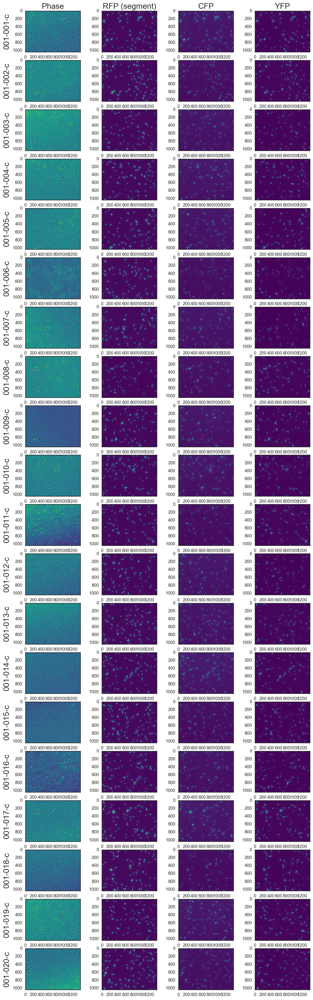

In [5]:
# So we have it, the interpixel distance
physical_size = 0.065  # microns

# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 4, figsize=(12,40))
    ax[0,0].set_title('Phase')
    ax[0,1].set_title('RFP (segment)')
    ax[0,2].set_title('CFP')
    ax[0,3].set_title('YFP')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='p','image'].values[i], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','image'].values[i], cmap=plt.cm.viridis)
        ax[i,2].imshow(df.loc[df.channel=='c','image'].values[i], cmap=plt.cm.viridis)
        ax[i,3].imshow(df.loc[df.channel=='y','image'].values[i], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])
        #ax[1].imshow(df.image[0][subim], cmap=plt.cm.viridis)

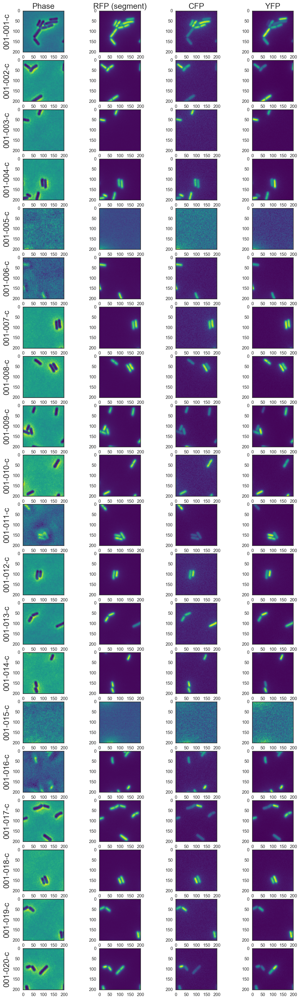

In [6]:
# Zoom in
subim = np.s_[100:300, 850:1050]
# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 4, figsize=(12,40))
    ax[0,0].set_title('Phase')
    ax[0,1].set_title('RFP (segment)')
    ax[0,2].set_title('CFP')
    ax[0,3].set_title('YFP')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='p','image'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','image'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,2].imshow(df.loc[df.channel=='c','image'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,3].imshow(df.loc[df.channel=='y','image'].values[i][subim], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])
        #ax[1].imshow(df.image[0][subim], cmap=plt.cm.viridis)

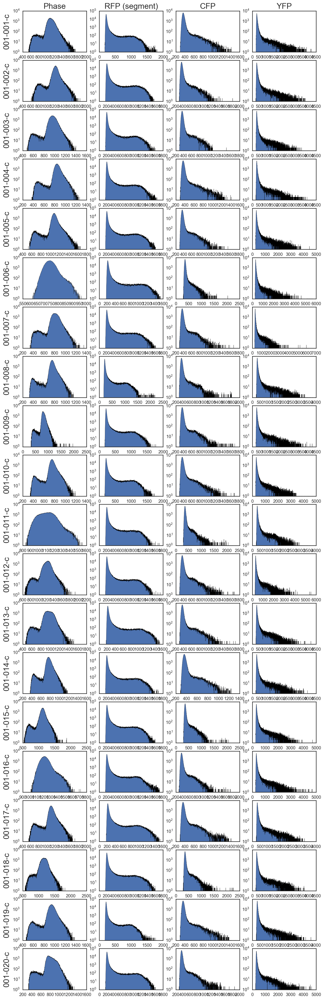

In [7]:
# Look at all the histograms for strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 4, figsize=(12,40))
    ax[0,0].set_title('Phase')
    ax[0,1].set_title('RFP (segment)')
    ax[0,2].set_title('CFP')
    ax[0,3].set_title('YFP')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        hist_p, bins_p = df.loc[df.channel=='p','histogram'].values[i]
        hist_r, bins_r = df.loc[df.channel=='r','histogram'].values[i]
        hist_c, bins_c = df.loc[df.channel=='c','histogram'].values[i]
        hist_y, bins_y = df.loc[df.channel=='y','histogram'].values[i]
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])
        ax[i,0].fill_between(bins_p, hist_p, cmap=plt.cm.viridis)        
        ax[i,1].fill_between(bins_r, hist_r, cmap=plt.cm.viridis)        
        ax[i,2].fill_between(bins_c, hist_c, cmap=plt.cm.viridis)        
        ax[i,3].fill_between(bins_y, hist_y, cmap=plt.cm.viridis)
    
    # Make log scale
    for i in ax:
        for j in i:
            j.set_yscale('log')

There are clearly some strange images here. For example, the phase of 006 is unimodal. Looking back at the image itself, we can see that there was inversion of the image. We need to deal with this somehow.

Let's try a very simple segmentation first. It looks from the histograms like values below about 500 in the RFP channel are background.

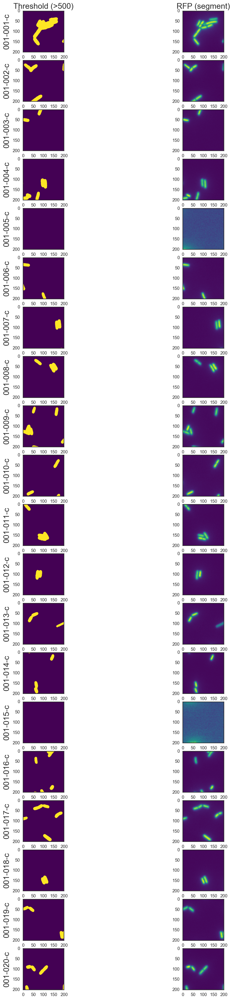

In [8]:
# Make threshold greater than 500
df.thresh = None
df.loc[df.channel=='r','thresh'] = [df.loc[(df.channel=='r'),'image'].values[i]>500 for i, _ in enumerate(df.loc[(df.channel=='r'),'image'])]

# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 2, figsize=(12,40))
    ax[0,0].set_title('Threshold (>500)')
    ax[0,1].set_title('RFP (segment)')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='r','thresh'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','image'].values[i][subim], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])

This is OK, but clearly not perfect. Instead, let's try the thresholding function from Tutorial 9:

In [9]:
# Reuse thresholding function from Tutorial 9
def bebi103_thresh(im, selem, white_true=True, k_range=(0.5, 1.5), 
                   min_size=100):
    """
    Threshold image as described above.  Morphological mean filter is 
    applied using selem.
    """
    
    # Determine comparison operator
    if white_true:
        compare = np.greater
        sign = -1
    else:
        compare = np.less
        sign = 1
    
    # Do the mean filter
    im_mean = skimage.filter.rank.mean(im, selem)

    # Compute number of pixels in binary image as a function of k
    k = np.linspace(k_range[0], k_range[1], 100)
    n_pix = np.empty_like(k)
    for i in range(len(k)):
        n_pix[i] = compare(im, k[i] * im_mean).sum() 

    # Compute rough second derivative
    dn_pix_dk2 = np.diff(np.diff(n_pix))

    # Find index of maximal second derivative
    max_ind = np.argmax(sign * dn_pix_dk2)

    # Use this index to set k
    k_opt = k[max_ind - sign * 2]

    # Threshold with this k
    im_bw = compare(im, k_opt * im_mean)

    # Remove all the small objects
    im_bw = skimage.morphology.remove_small_objects(im_bw, min_size=min_size)
   
    return im_bw, k_opt, im_mean

In [10]:
# Threshold
df.thresh = None
selem = skimage.morphology.disk(10)
df.loc[df.channel=='r','thresh'] = [bebi103_thresh(df.loc[(df.channel=='r'),'image'].values[i], selem) for i, _ in enumerate(df.loc[(df.channel=='r'),'image'])]

//anaconda/lib/python3.4/site-packages/skimage/filters/rank/generic.py:68: UserWarning: Bitdepth of 11 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


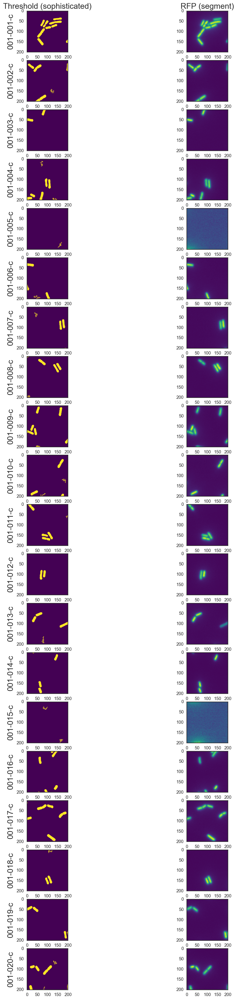

In [11]:
# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 2, figsize=(12,40))
    ax[0,0].set_title('Threshold (sophisticated)')
    ax[0,1].set_title('RFP (segment)')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='r','thresh'].values[i][0][subim], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','image'].values[i][subim], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])

Pretty good! There are some small regions which are false positives, though. We should increase the "min_size" parameter.

//anaconda/lib/python3.4/site-packages/skimage/filters/rank/generic.py:68: UserWarning: Bitdepth of 11 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


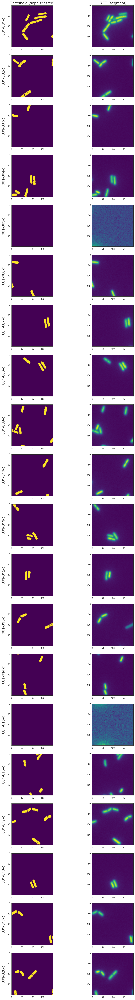

In [12]:
# Threshold
df.thresh = None
selem = skimage.morphology.disk(5)
df.loc[df.channel=='r','thresh'] = [bebi103_thresh(df.loc[(df.channel=='r'),'image'].values[i], selem, min_size=200) for i, _ in enumerate(df.loc[(df.channel=='r'),'image'])]

# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 2, figsize=(12,80))
    ax[0,0].set_title('Threshold (sophisticated)')
    ax[0,1].set_title('RFP (segment)')
    for i, _ in enumerate(df.index[(df.channel=='c') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='r','thresh'].values[i][0][subim], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','image'].values[i][subim], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='c','filepath'].values[i][-13:-4])

In [13]:
def zero_crossing_filter(im, thresh):
    """
    Returns image with 1 if there is a zero crossing and 0 otherwise.
    
    thresh is the the minimal value of the gradient, as computed by Sobel
    filter, at crossing to count as a crossing.
    """
    # Square structuring element
    selem = skimage.morphology.square(3)
    
    # Do max filter and min filter
    im_max = scipy.ndimage.filters.maximum_filter(im, footprint=selem)
    im_min = scipy.ndimage.filters.minimum_filter(im, footprint=selem)
    
    # Compute gradients using Sobel filter
    im_grad = skimage.filter.sobel(im)
    
    # Return edges
    return (((im >= 0) & (im_min < 0)) | ((im <= 0) & (im_max > 0))) \
                & (im_grad >= thresh)

In [14]:
df.image.values[2].astype(float)

array([[ 243.,  261.,  250., ...,  401.,  363.,  339.],
       [ 241.,  251.,  246., ...,  405.,  352.,  318.],
       [ 249.,  249.,  236., ...,  402.,  358.,  340.],
       ..., 
       [ 223.,  219.,  219., ...,  218.,  211.,  219.],
       [ 227.,  216.,  215., ...,  226.,  213.,  215.],
       [ 233.,  205.,  228., ...,  197.,  225.,  220.]])

In [15]:
im_float = df.image.values[2].astype(float)
im_LoG = scipy.ndimage.filters.gaussian_laplace(im_float, 2.0)

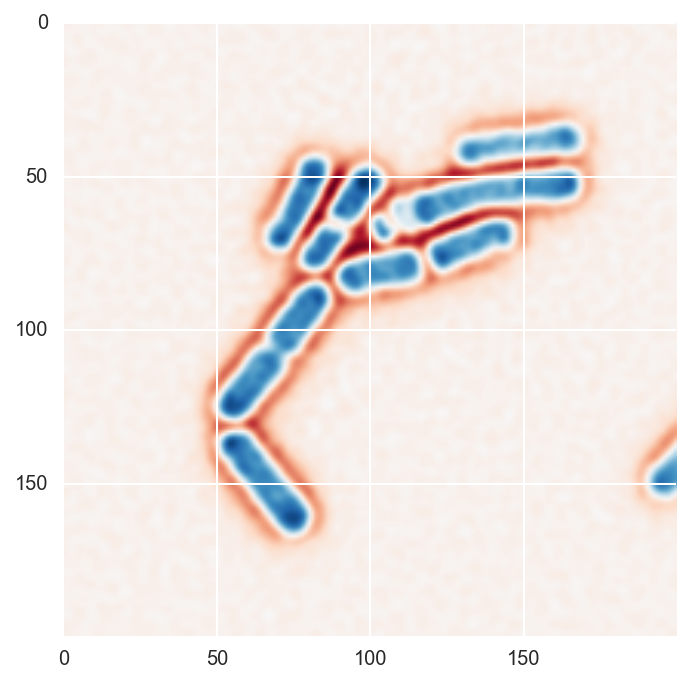

In [16]:
plt.imshow(im_LoG[subim], cmap=plt.cm.RdBu_r)

<function __main__.edgethresh>

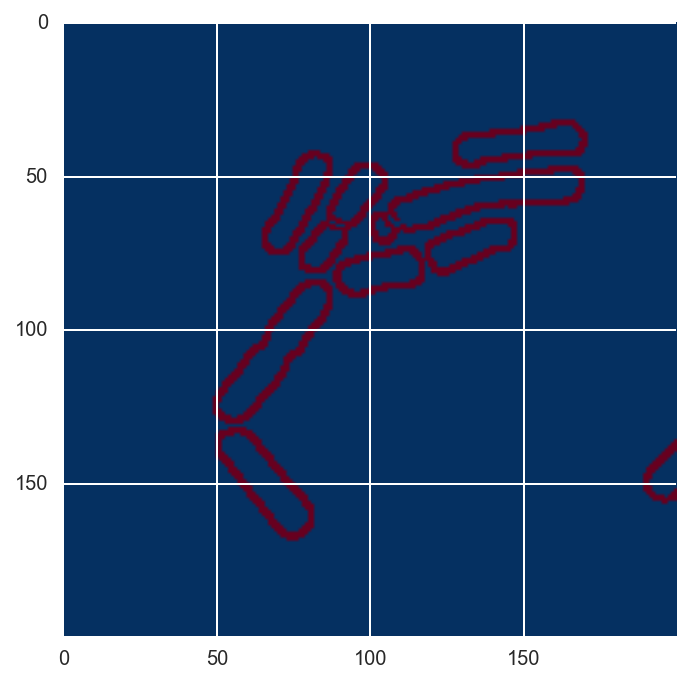

In [17]:
def edgethresh(threshold):
    im_edge = zero_crossing_filter(im_LoG, threshold)
    plt.imshow(im_edge[subim], cmap=plt.cm.RdBu_r)
ipywidgets.interact(edgethresh, threshold=(0,10,0.001))

In [18]:
df['im_float'] = [im.astype(float) for im in df.image]

In [19]:
# Compute LoG
# im_LoG = scipy.ndimage.filters.gaussian_laplace(im_float, 2.0)
im_LoG_list = []
im_edges_list = []
for i, _ in enumerate(df.loc[(df.channel=='r'),'im_float']):
    im_LoG = scipy.ndimage.filters.gaussian_laplace(df.loc[(df.channel=='r'),'im_float'].values[i], 2.0)
    im_LoG_list.append(im_LoG)
    im_edges_list.append(zero_crossing_filter(im_LoG, 3))
# pandas doesn't like setting a column to a list of arrays, so I first make the list into a pandas Series:
df.loc[df.channel=='r','LoG'] = pd.Series(im_LoG_list, index=df[df.channel=='r'].index)
# Skeletonize edges
im_edges_list = [skimage.morphology.skeletonize(im) for im in im_edges_list]
df.loc[df.channel=='r','edges'] = im_edges_list

# Fill holes
df.loc[df.channel=='r','segmented'] = [scipy.ndimage.morphology.binary_fill_holes(im) for im in df.loc[df.channel=='r','edges']]

# Remove small objects that are not bacteria
df.loc[df.channel=='r','segmented'] = [skimage.morphology.remove_small_objects(im, min_size=100) for im in df.loc[df.channel=='r','segmented']]

# Clear border with large buffer size b/c LoG procedure came off border
df.loc[df.channel=='r','segmented'] = [skimage.segmentation.clear_border(im, buffer_size=5) for im in df.loc[df.channel=='r','segmented']]

# df.loc[df.channel=='r','edges'] = [scipy.ndimage.filters.gaussian_laplace(df.loc[(df.channel=='r'),'image'].values[i], 2.0) for i, _ in enumerate(df.loc[(df.channel=='r'),'image'])]

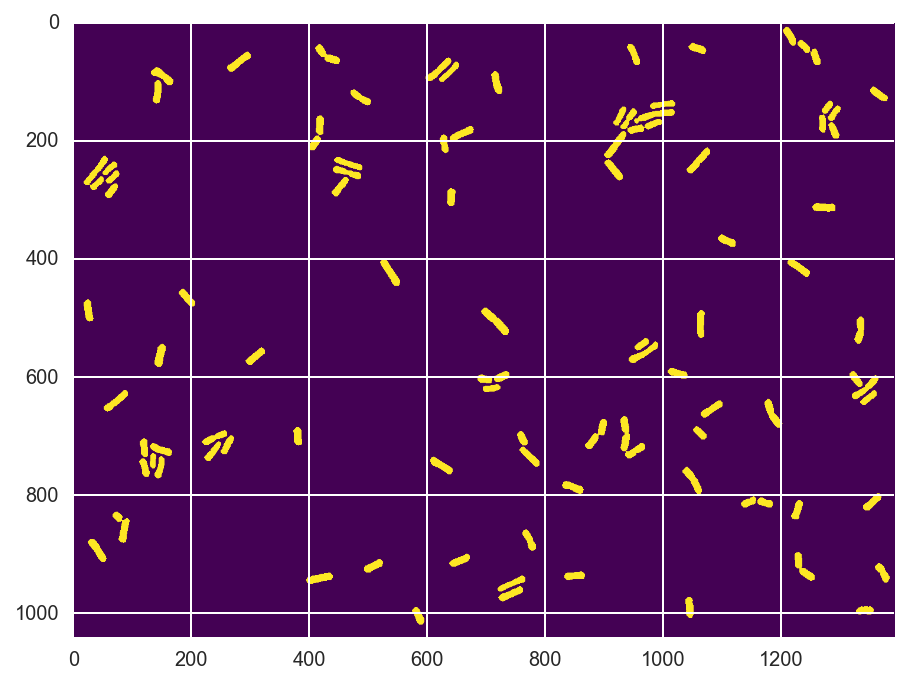

In [20]:
plt.imshow(df['segmented'][2], cmap=plt.cm.viridis)

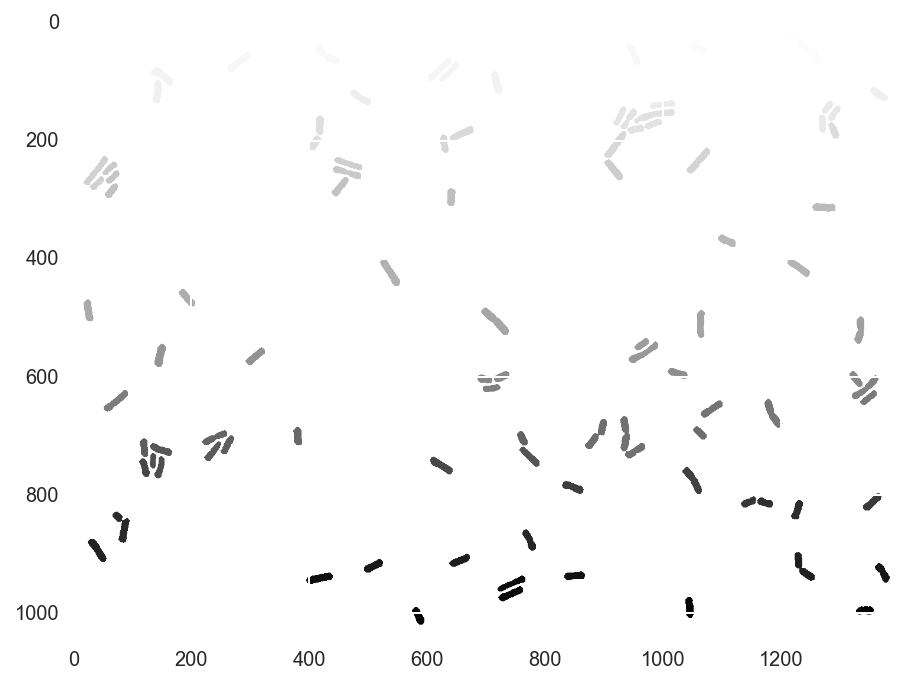

In [21]:
plt.imshow(skimage.measure.label(df['segmented'][2], background=0))

In [22]:
# Label binary image; background kwarg says value in im_bw to consider backgr.
labeled_list = [skimage.measure.label(im, background=0) for im in df.loc[df.channel=='r','segmented']]
# pandas doesn't like setting a column to a list of arrays, so I first make the list into a pandas Series:
df.loc[df.channel=='r','labeled'] = pd.Series(labeled_list, index=df[df.channel=='r'].index)

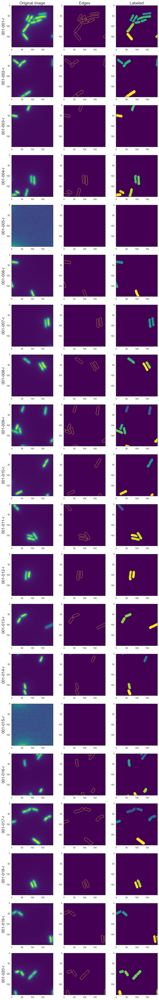

In [23]:
# Look at all the strain 001 images
with sns.axes_style('white'):
    fig, ax = plt.subplots(len(df.index[(df.channel=='c') & (df.strain=='001')]), 3, figsize=(12,80))
    ax[0,0].set_title('Original image')
    ax[0,1].set_title('Edges')
    ax[0,2].set_title('Labeled')
    for i, _ in enumerate(df.index[(df.channel=='r') & (df.strain=='001')]):
        ax[i,0].imshow(df.loc[df.channel=='r','image'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,1].imshow(df.loc[df.channel=='r','edges'].values[i][subim], cmap=plt.cm.viridis)
        ax[i,2].imshow(df.loc[df.channel=='r','labeled'].values[i][subim], cmap=plt.cm.viridis)
        
        ax[i,0].set_ylabel(df.loc[df.channel=='r','filepath'].values[i][-13:-4])

In [24]:
# Get regionprops for all images,
# using labeled segmentation of corresponding red channel
regionprops_df = pd.DataFrame()
for i in df.index:
    regionprops = skimage.measure.regionprops\
    (df.loc[(df.strain==df.ix[i]['strain'])
            & (df.field_of_view==df.ix[i]['field_of_view'])
            & (df.channel=='r'),'labeled'].values[0],
     intensity_image=df.ix[i]['image'])
    regionprops_df_temp = regionprops_to_df.regionprops_to_df(regionprops)
    regionprops_df_temp['strain'] = df.ix[i]['strain']
    regionprops_df_temp['field_of_view'] = df.ix[i]['field_of_view']
    regionprops_df_temp['channel'] = df.ix[i]['channel']
    
    regionprops_df = regionprops_df.append(regionprops_df_temp, ignore_index=True)
regionprops_df

,area,bbox,centroid,convex_area,eccentricity,equivalent_diameter,euler_number,extent,filled_area,inertia_tensor_eigvals,...,min_intensity,minor_axis_length,orientation,perimeter,solidity,weighted_centroid,weighted_local_centroid,strain,field_of_view,channel
0,595,"(30, 1227, 73, 1266)","(50.6067226891, 1248.12941176)",778,0.962780,27.524126,0,0.354800,595,"(227.270610174, 16.6033535292)",...,493,16.298885,-0.805615,139.124892,0.764781,"(50.5097956966, 1248.42317849)","(20.5097956966, 21.4231784878)",001,001,c
1,355,"(35, 1042, 54, 1073)","(44.3070422535, 1057.16056338)",374,0.900218,21.260293,0,0.602716,355,"(66.1251776566, 12.5378653905)",...,395,14.163539,-0.326992,78.426407,0.949198,"(44.1363993241, 1057.14676719)","(9.13639932406, 15.146767191)",001,001,c
2,573,"(37, 410, 71, 452)","(55.8551483421, 429.767888307)",706,0.955512,27.010484,0,0.401261,573,"(184.595554382, 16.0590816695)",...,543,16.029514,-0.624356,121.639610,0.811615,"(56.2053050562, 430.365255731)","(19.2053050562, 20.3652557306)",001,001,c
3,415,"(37, 938, 73, 960)","(54.265060241, 949.371084337)",458,0.951941,22.986831,0,0.523990,415,"(112.012085028, 10.5076652989)",...,458,12.966212,-1.171984,93.840620,0.906114,"(53.7419682724, 949.291029876)","(16.7419682724, 11.2910298762)",001,001,c
4,551,"(50, 261, 84, 302)","(66.891107078, 280.735027223)",614,0.963577,26.486883,0,0.395265,551,"(172.133468778, 12.3107787707)",...,376,14.034688,0.655382,113.195959,0.897394,"(66.6023238605, 280.674467449)","(16.6023238605, 19.6744674486)",001,001,c
5,587,"(60, 597, 100, 641)","(80.6354344123, 618.921635434)",652,0.976458,27.338464,0,0.333523,587,"(230.114673145, 10.707095499)",...,455,13.088679,0.736847,124.166522,0.900307,"(80.3381646187, 619.116453447)","(20.3381646187, 22.1164534471)",001,001,c
6,404,"(67, 620, 101, 654)","(84.051980198, 637.361386139)",439,0.975024,22.680141,0,0.349481,404,"(152.632254118, 7.52899845489)",...,432,10.975608,0.779177,99.781746,0.920273,"(83.8248482092, 637.266062695)","(16.8248482092, 17.266062695)",001,001,c
7,530,"(76, 132, 107, 170)","(90.7641509434, 151.052830189)",617,0.942096,25.977239,0,0.449915,530,"(138.368274231, 15.5601024154)",...,431,15.778518,-0.605513,105.882251,0.858995,"(90.4415322885, 150.70562752)","(14.4415322885, 18.7056275204)",001,001,c
8,467,"(83, 708, 122, 727)","(102.349036403, 717.102783726)",500,0.941804,24.384480,0,0.630229,467,"(113.197765175, 12.7918995954)",...,473,14.306306,-1.330341,95.597980,0.934000,"(102.038611079, 717.027372683)","(19.0386110785, 9.02737268292)",001,001,c
9,448,"(98, 135, 138, 150)","(117.814732143, 142.582589286)",482,0.947727,23.883285,0,0.746667,448,"(115.140055741, 11.722816947)",...,440,13.695440,1.475540,94.284271,0.929461,"(117.081632072, 142.542646339)","(19.0816320721, 7.54264633883)",001,001,c


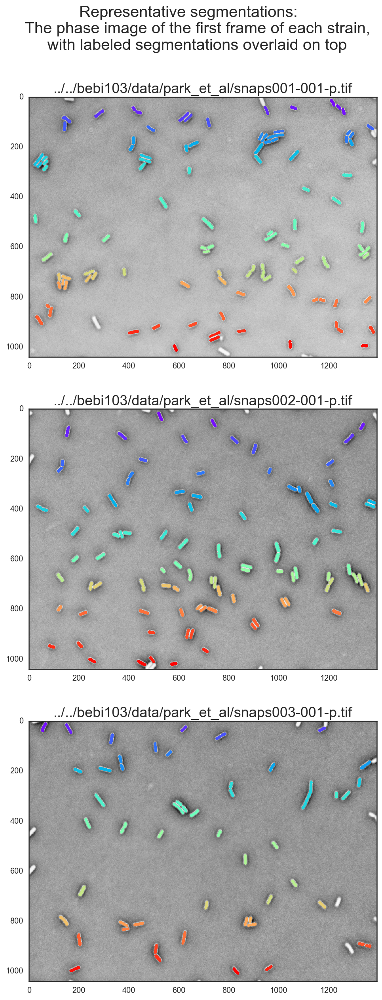

In [25]:
# For my representative segmentations,
# instead of converting the image to RGB
# and colouring one of the channels with the segment,
# I will overlay the segment on top of the phase image
# with the alpha of the background of the segment image
# set to zero. This allows me to keep the colour information
# of the labels.
overlay_cmap = plt.cm.rainbow
overlay_cmap._init()
overlay_cmap._lut[0,-1] = 0

with sns.axes_style('white'):
    fig, ax = plt.subplots(3,1, figsize=(20,20))
    plt.suptitle('Representative segmentations:\n\
    The phase image of the first frame of each strain,\n\
    with labeled segmentations overlaid on top', size=20)
    for i in range(3):
        strain = '00' + str(i+1)
        ax[i].set_title(df.loc[(df.channel=='p') & (df.strain==strain),'filepath'].values[0])
        ax[i].imshow(df.loc[(df.channel=='p') & (df.strain==strain),'image'].values[0])
        ax[i].imshow(df.loc[(df.channel=='r') & (df.strain==strain),'labeled'].values[0], cmap=overlay_cmap)

b) As discussed in class, we are not entirely sure of how to analyze the correlation or lack thereof of the two different σ factors. Generate plots that you think may be useful and/or develop metrics for correlation among the samples. This question is very open-ended and is your chance to experience thinking about real results with the members of your group.

Pearson r for strain 001 = -0.190100729214
Pearson r for strain 002 = 0.945969486087
Pearson r for strain 003 = 0.874669562172


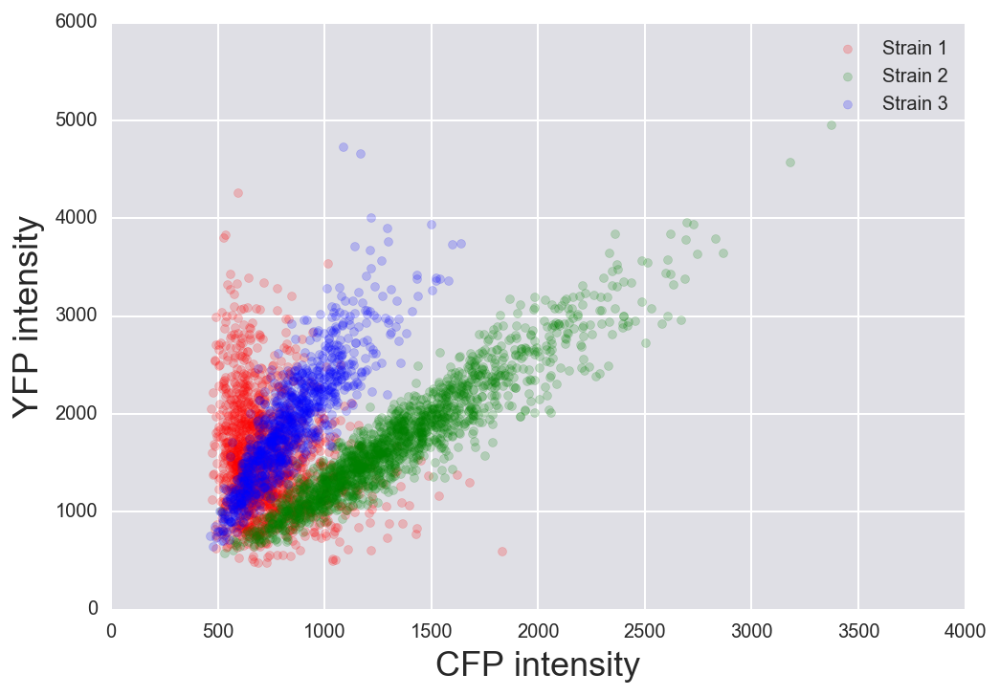

In [31]:
for i in range(3):
    strain = ['001','002','003'][i]
    cval = regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.channel=='c'),'mean_intensity']
    yval = regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.channel=='y'),'mean_intensity']
    color = 'rgb'[i]
    _ = plt.scatter([cval],[yval], color=color, alpha=0.2)
    # Pearson correlation
    r, _ = scipy.stats.pearsonr(cval,yval)
    print('Pearson r for strain', strain,'=', r)
_ = plt.legend(['Strain ' + str(i+1) for i in range(3)])
_ = plt.xlabel('CFP intensity')
_ = plt.ylabel('YFP intensity')

It seems clear that YFP and CFP intensities are correlated with each other far more in strains 2 and 3 than in strain 1.

But is this small or large? Let's take a cue from Costes' method in the colocalisation tutorial, and randomise pairs of mean intensities.

In [110]:
# Shuffle only within each field of view, as exposure differences between fields of view would artificially lower the correlation.
for shuffle_number in range(100):
    shuffle_number_column_heading = 'shuffle_{:03d}'.format(shuffle_number)
    for strain in regionprops_df.strain.unique():
        for field_of_view in regionprops_df.loc[(regionprops_df.strain==strain),'field_of_view'].unique():
            listtoshuffle = regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.field_of_view==field_of_view) & (regionprops_df.channel=='c'),'mean_intensity'].values
            np.random.shuffle(listtoshuffle)
            regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.field_of_view==field_of_view) & (regionprops_df.channel=='c'),shuffle_number_column_heading] = listtoshuffle
#regionprops_df.loc[(regionprops_df.strain=='002') & (regionprops_df.channel=='c')]

In [109]:
df_pearson = pd.DataFrame()
for shuffle_number in range(2):
    shuffle_number_column_heading = 'shuffle_{:03d}'.format(shuffle_number)
    for strain in regionprops_df.strain.unique():
        cval = regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.channel=='c'),shuffle_number_column_heading]
        yval = regionprops_df.loc[(regionprops_df.strain==strain) & (regionprops_df.channel=='y'),'mean_intensity']

        # Pearson correlation
        r, _ = scipy.stats.pearsonr(cval,yval)
        df_pearson_temp = pd.DataFrame(columns=['strain', 'r'])
        df_pearson_temp.strain = pd.Series(strain)
        df_pearson_temp.r = pd.Series(r)
        df_pearson = df_pearson.append(df_pearson_temp)
for strain in regionprops_df.strain.unique():
    print('The Mean Pearson r coefficient for randomised pairings of strain', strain, 'is', np.mean(df_pearson.loc[df_pearson.strain==strain,'r']), 'with s.d.', np.std(df_pearson.loc[df_pearson.strain==strain,'r']))

The Mean Pearson r coefficient for randomised pairings of strain 001 is 0.036448282763733436 with s.d. 0.019689145935413346
The Mean Pearson r coefficient for randomised pairings of strain 002 is 0.017945091014042073 with s.d. 0.013456801273329464
The Mean Pearson r coefficient for randomised pairings of strain 003 is 0.0029713858540773037 with s.d. 0.026165234791282535


What does this mean?
Recall from tutorial 9a:

There are four different strains. We have
1. $\sigma_B$-CFP, $\sigma_W$-YFP, constitutive RFP
2. $\sigma_B$-CFP, $\sigma_B$-YFP, constitutive RFP
3. $\sigma_W$-CFP, $\sigma_W$-YFP, constitutive RFP
4. only constitutive RFP; no CFP or YFP

The central question is: do the $\sigma$ factors "share" the available RNA polymerases at the same time, or does one $\sigma$ factor get all of the polymerases while the other does not. We have found that the intensity of CFP and YFP in each cell in strain 1 appears to be uncorrelated (compare to randomised pairs, and contrast with strain 2 and 3), which suggests that whether or not $\sigma_B$ is using RNA polymerase in a cell is independent of whether $\sigma_W$ is.